In [1]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.animation as animation
from IPython.display import HTML
import math
import heapq

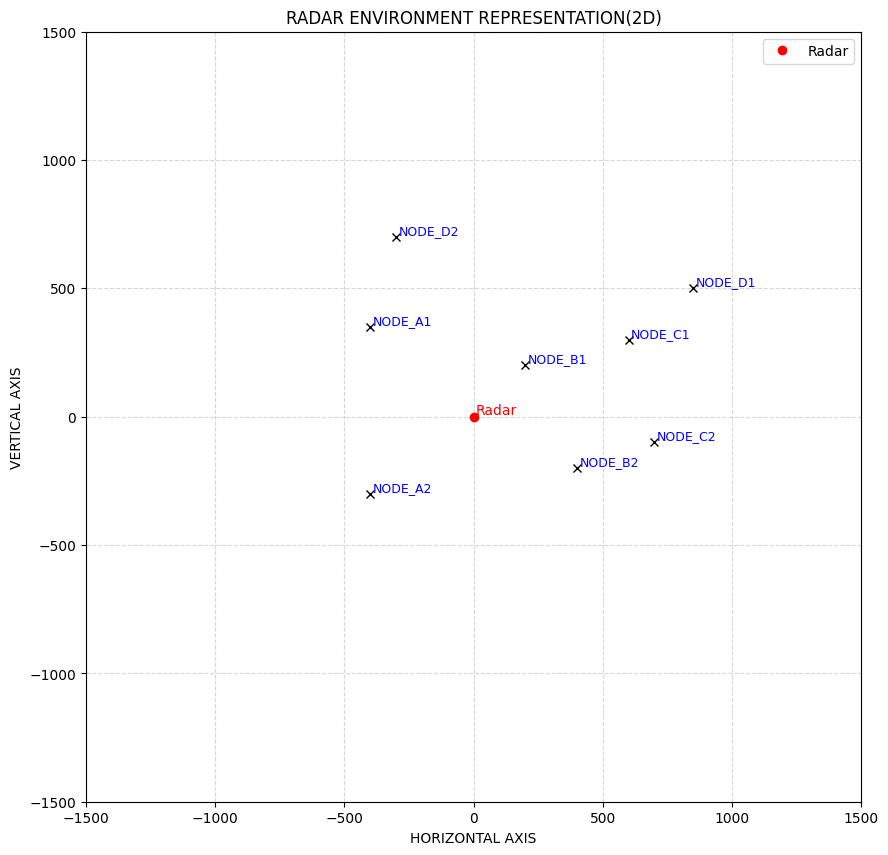

In [2]:
grid = 1500;
fig, axis = plt.subplots(figsize = (10,10))
axis.grid(True,linestyle = '--',alpha = 0.5)
axis.set_xlim(-grid,grid)
axis.set_ylim(-grid,grid)
axis.set_title("RADAR ENVIRONMENT REPRESENTATION(2D)")
axis.set_xlabel("HORIZONTAL AXIS")
axis.set_ylabel("VERTICAL AXIS")
radar = (0,0)
objects = {
    "NODE_A1":(-400,350),
    "NODE_A2":(-400, -300),
    "NODE_B1":(200, 200),
    "NODE_B2":(400, -200),
    "NODE_C1":(600, 300),
    "NODE_C2":(700, -100),
    "NODE_D1":(850, 500),
    "NODE_D2":(-300, 700),   
}
axis.plot(radar[0],radar[1],'ro',label = 'Radar')
axis.text(radar[0]+10,radar[1]+10,"Radar",color = 'red')

for name,(x,y) in objects.items():
    axis.plot(x,y,'kx')
    axis.text(x+10,y+10,name,fontsize = 9,color = 'b')
axis.legend()
plt.show()

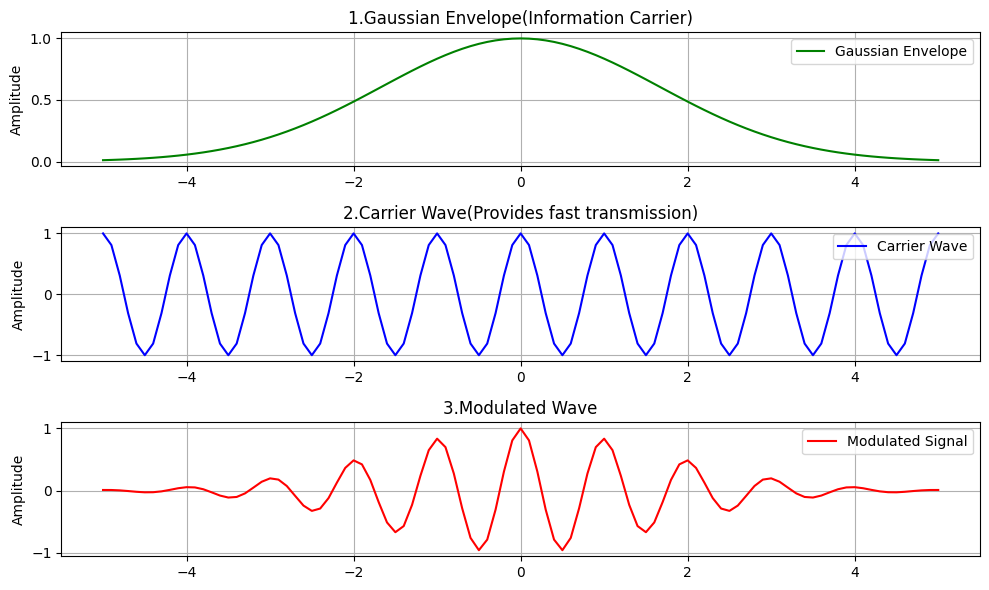

In [3]:
sampling_frequency = 10e6
t = pulse_width = 5e-6
tau = envelop_width = (pulse_width)/3
f_c = carrier_frequency = 1e6
T = time_vector = np.arange(-pulse_width,pulse_width,1/sampling_frequency)

gaussian_envelop = np.exp(-0.5*(T/tau)**2)
carrier_wave = np.cos(2*np.pi*f_c*T)
final_wave = gaussian_envelop*carrier_wave

plt.figure(figsize = (10,6))

plt.subplot(3,1,1)
plt.plot(T*1e6,gaussian_envelop,'g',label = "Gaussian Envelope")
plt.ylabel("Amplitude")
plt.title("1.Gaussian Envelope(Information Carrier)")
plt.legend()
plt.grid()

plt.subplot(3,1,2)
plt.plot(T*1e6,carrier_wave,'b',label = "Carrier Wave")
plt.ylabel("Amplitude")
plt.title("2.Carrier Wave(Provides fast transmission)")
plt.legend(loc = 'upper right')
plt.grid()

plt.subplot(3,1,3)
plt.plot(T*1e6,final_wave,'r',label = "Modulated Signal")
plt.ylabel("Amplitude")
plt.title("3.Modulated Wave")
plt.legend()
plt.grid()

plt.tight_layout()
plt.show()

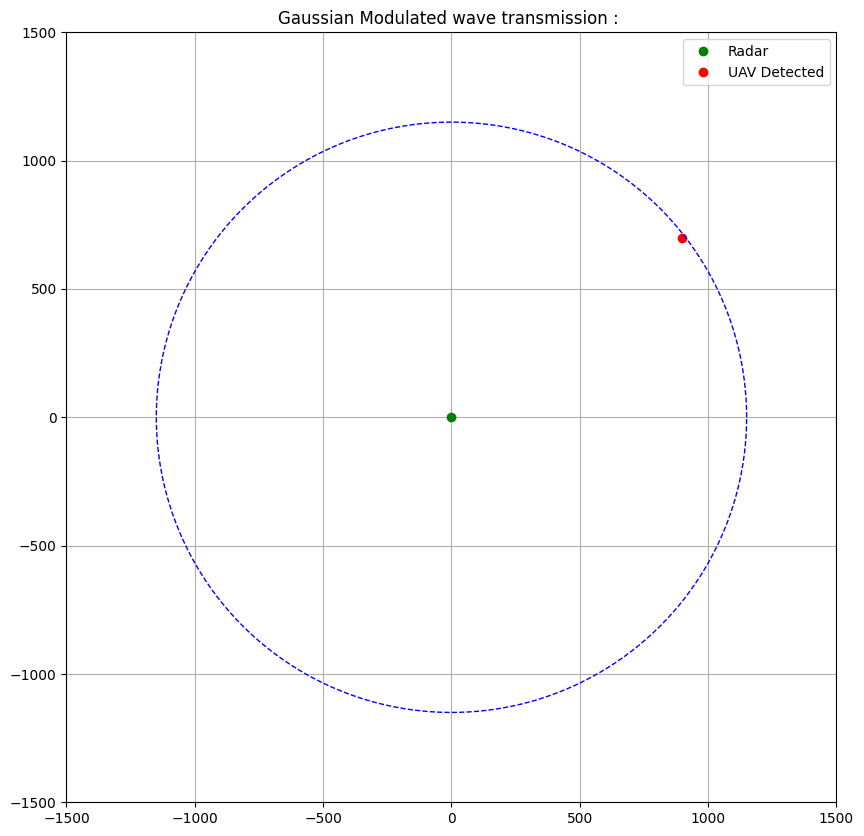

In [4]:
radar = (0,0)
uav_pos = [900.0,700.0]
uav_distance = np.linalg.norm(uav_pos)
wave_speed = 10 
frame_stop = 10;
fig, ax = plt.subplots(figsize = (10,10))
ax.set_xlim(-1500,1500)
ax.set_ylim(-1500,1500)
ax.set_aspect('equal')
ax.grid(True)
ax.set_title("Gaussian Modulated wave transmission : ")

ax.plot(*radar,'go',label = 'Radar')
uav = ax.plot([],[], 'ro')[0]
uav.set_visible(False)
ax.legend()

outgoing_pulse = ax.plot([],[],'b--',linewidth=1)[0]
returning_pulse = ax.plot([],[],'purple',linewidth=1)[0]

phase = 'outgoing'
frame_no = 0

def update(frame):
    global phase,frame_no
    if phase == 'outgoing':
        radius = wave_speed * frame_no;
        theta = np.linspace(0, 2*np.pi , 200)
        x = radius*np.cos(theta)
        y = radius*np.sin(theta)
        outgoing_pulse.set_data(x,y)
        if radius>= uav_distance:
            uav.set_data([uav_pos[0]], [uav_pos[1]])
            uav.set_visible(True)
            uav.set_label("UAV Detected")
            ax.legend()
            phase = 'pause'
            frame_no = 0
    elif phase == 'pause':
        frame_no+=1
        if frame_no>=frame_stop:
            phase = 'return'
            frame_no = 0
    elif phase == 'return':
        radius = uav_distance - wave_speed * frame_no
        radius = max(radius,0)
        theta = np.linspace(0, 2*np.pi, 200)
        x = radius * np.cos(theta)
        y = radius * np.sin(theta)
        returning_pulse.set_data(x,y)
    frame_no+=1
    return outgoing_pulse, returning_pulse
ani = animation.FuncAnimation(fig, update, frames = 300, interval = 50, blit = True)
HTML(ani.to_jshtml())

[]

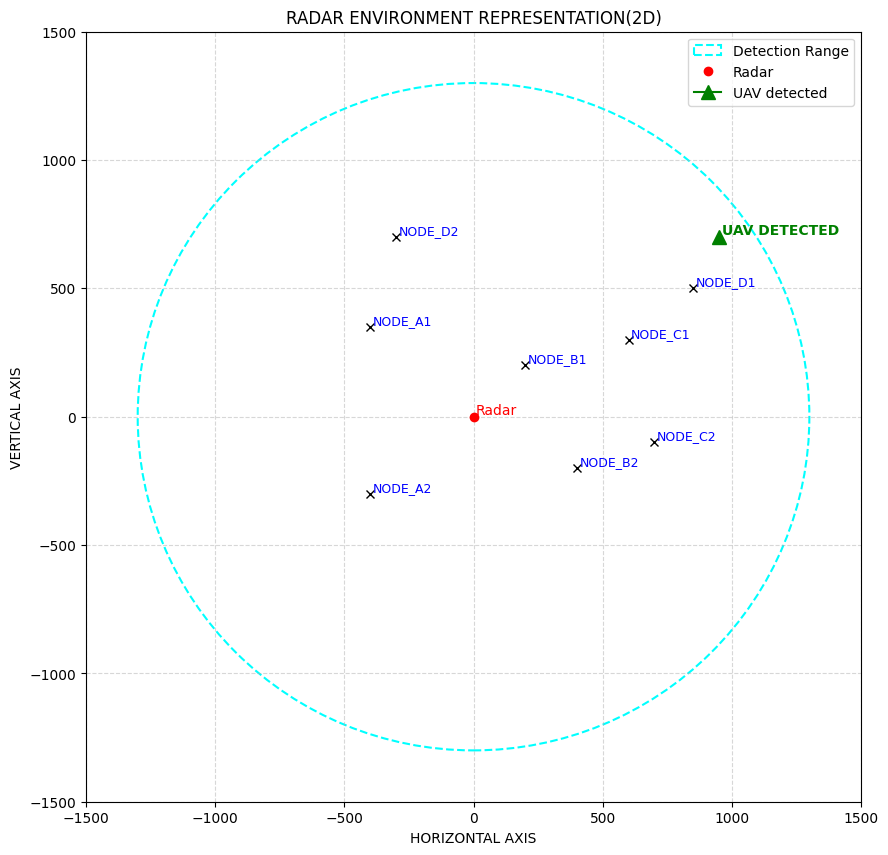

In [5]:
grid = 1500;
fig, axis = plt.subplots(figsize = (10,10))
axis.grid(True,linestyle = '--',alpha = 0.5)
axis.set_xlim(-grid,grid)
axis.set_ylim(-grid,grid)
axis.set_title("RADAR ENVIRONMENT REPRESENTATION(2D)")
axis.set_xlabel("HORIZONTAL AXIS")
axis.set_ylabel("VERTICAL AXIS")
radar = (0,0)
objects = {
    "NODE_A1":(-400,350),
    "NODE_A2":(-400, -300),
    "NODE_B1":(200, 200),
    "NODE_B2":(400, -200),
    "NODE_C1":(600, 300),
    "NODE_C2":(700, -100),
    "NODE_D1":(850, 500),
    "NODE_D2":(-300, 700),   
}
range = 1300
circle = plt.Circle(radar,range,color = 'cyan',fill = False,linestyle='--',linewidth = 1.5,label = "Detection Range")
axis.add_patch(circle)
axis.plot(radar[0],radar[1],'ro',label = 'Radar')
axis.text(radar[0]+10,radar[1]+10,"Radar",color = 'red')

for name,(x,y) in objects.items():
    axis.plot(x,y,'kx')
    axis.text(x+10,y+10,name,fontsize = 9,color = 'b')



uav = (950,700)
axis.plot(uav[0],uav[1],marker='^',markersize = 10,color = 'green',label = "UAV detected")
axis.text(uav[0]+10,uav[1]+10,"UAV DETECTED",color = 'green',fontsize = '10',fontweight='bold')
axis.legend()
plt.plot()

In [6]:
uav_x = 900
uav_y = 700
distance = np.sqrt(uav_x**2 + uav_y**2)
print("Distance between radar and UAV : ",distance)

Distance between radar and UAV :  1140.175425099138


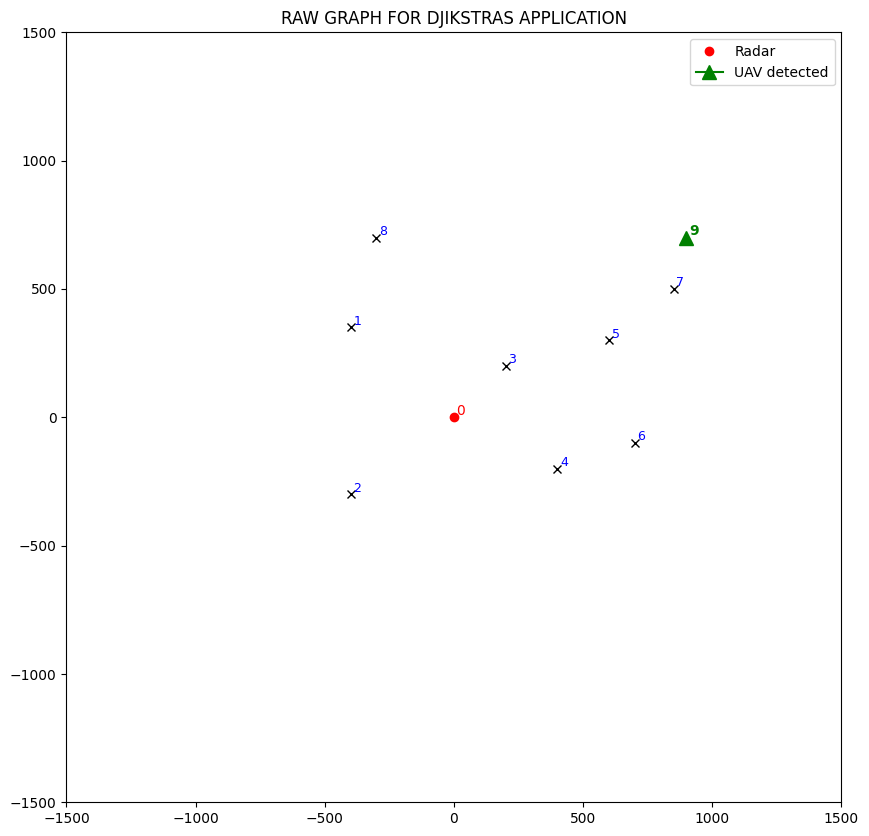

In [23]:
grid = 1500;
fig, axis = plt.subplots(figsize = (10,10))
axis.grid(True,linestyle = '--',alpha = 0.5)
axis.set_xlim(-grid,grid)
axis.set_ylim(-grid,grid)
objects = {
                    
    1: (-400, 350),           
    2: (-400, -300),          
    3: (200, 200),            
    4: (400, -200),
    5: (600, 300),
    6: (700, -100),
    7: (850, 500),           
    8: (-300, 700),
                
}
radar = (0,0)
axis.set_title("RAW GRAPH FOR DJIKSTRAS APPLICATION")
axis.plot(radar[0],radar[1],'ro',label = "Radar")
axis.text(radar[0]+10,radar[1]+10,"0",color='red',)
for name,(x,y) in objects.items():
    axis.plot(x,y,'kx')
    axis.text(x+10,y+10,name,fontsize = 9,color = 'b')
uav = (900,700)
axis.plot(uav[0],uav[1],marker='^',markersize = 10,color = 'green',label = "UAV detected")
axis.text(uav[0]+10,uav[1]+10,"9",color = 'green',fontsize = '10',fontweight='bold')
axis.legend()


plt.grid(False)
plt.legend()
plt.show()

objects[0] =  (0, 0)     
objects[9] = (900, 700) 

In [24]:
altitude = {
    0: 100, 1: 250, 2: 180, 3: 500, 4: 300, 
    5: 200, 6: 310, 7: 650, 8: 320, 9: 900
}
edges = {
    (0, 3): altitude[3] - altitude[0],
    (3, 7): altitude[7] - altitude[3],
    (7, 9): altitude[9] - altitude[7],
    (0, 2): altitude[2] - altitude[0] + 50,
    (2, 5): altitude[5] - altitude[2] + 60,
    (5, 6): altitude[6] - altitude[5] + 80,
    (6, 8): altitude[8] - altitude[6] + 70,
    (8, 9): altitude[9] - altitude[8] + 90,
    (1, 4): altitude[4] - altitude[1] + 100,
    (4, 7): altitude[7] - altitude[4] + 110
}
print(f"Final edges  to be included in graph (u,v):w  : \n {edges}")

Final edges  to be included in graph (u,v):w  : 
 {(0, 3): 400, (3, 7): 150, (7, 9): 250, (0, 2): 130, (2, 5): 80, (5, 6): 190, (6, 8): 80, (8, 9): 670, (1, 4): 150, (4, 7): 460}


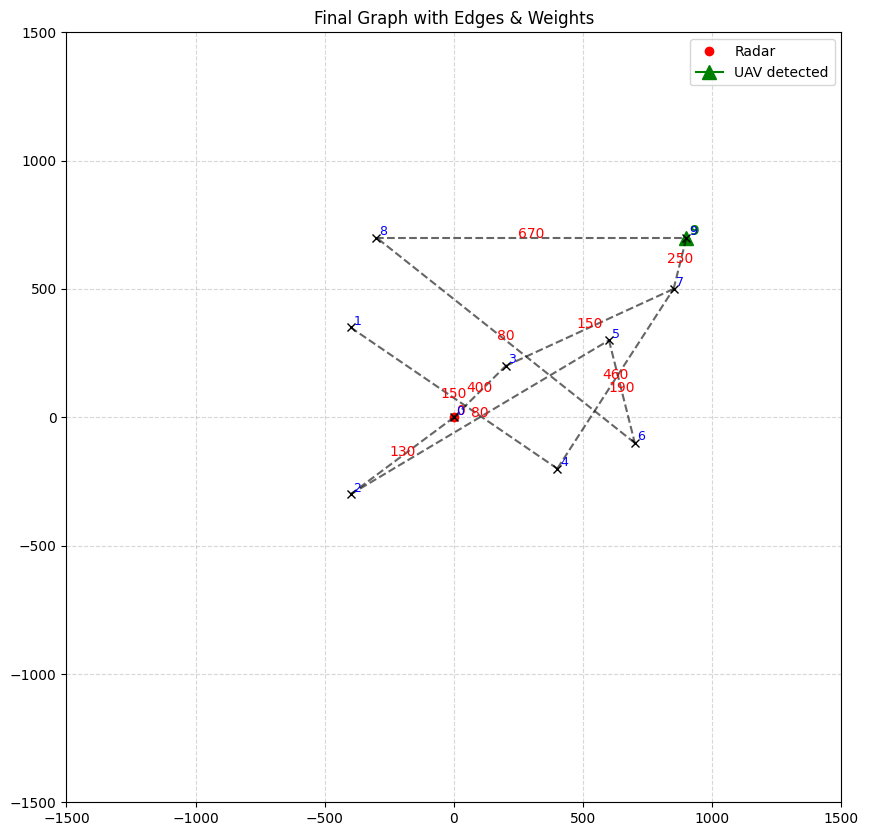

In [25]:
fig, axis = plt.subplots(figsize = (10,10))
axis.grid(True,linestyle = '--',alpha = 0.5)
axis.set_xlim(-grid,grid)
axis.set_ylim(-grid,grid)

axis.set_title("Final Graph with Edges & Weights")
axis.plot(radar[0],radar[1],'ro',label = "Radar")
axis.text(radar[0]+10,radar[1]+10,"0",color='red',)
axis.plot(uav[0], uav[1], marker='^', markersize=10, color='green', label="UAV detected")
axis.text(uav[0]+10, uav[1]+10, "9", color='green', fontsize=10, fontweight='bold')

for name,(x,y) in objects.items():
    axis.plot(x,y,'kx')
    axis.text(x+10,y+10,name,fontsize = 9,color = 'b')

for (u, v), w in edges.items():
    x1, y1 = objects[u]
    x2, y2 = objects[v]
    axis.plot([x1, x2], [y1, y2], 'k--', alpha=0.6)
    axis.text((x1 + x2) / 2, (y1 + y2) / 2, str(w), fontsize=10, color='red', ha='center')

axis.legend()
plt.show()


In [26]:
graph = {}
for (u, v), cost in edges.items():
    if u not in graph:
        graph[u] = []
    graph[u].append((cost, v))

In [36]:
import heapq

def dijkstra(graph, start, end):
    priority_queue = [(0, start)]  
    distances = {node: float('inf') for node in graph}
    distances[start] = 0
    parent = {start: None}

    while priority_queue:
        cost, u = heapq.heappop(priority_queue)
        
        if u == end:
            break

        for w, v in graph.get(u, []):
            new_w = cost + w
            if new_w < distances.get(v, float('inf')):
                distances[v] = new_w
                parent[v] = u
                heapq.heappush(priority_queue, (new_w, v))

    
    path = []
    i = 9
    while i is not None:
        path.append(i)
        i = parent[i]
    
    return path[::-1], distances


path, distances = dijkstra(graph, 0, 9)



print("Path to reach UAV starting from radar:", path)

Path to reach UAV starting from radar: [0, 3, 7, 9]


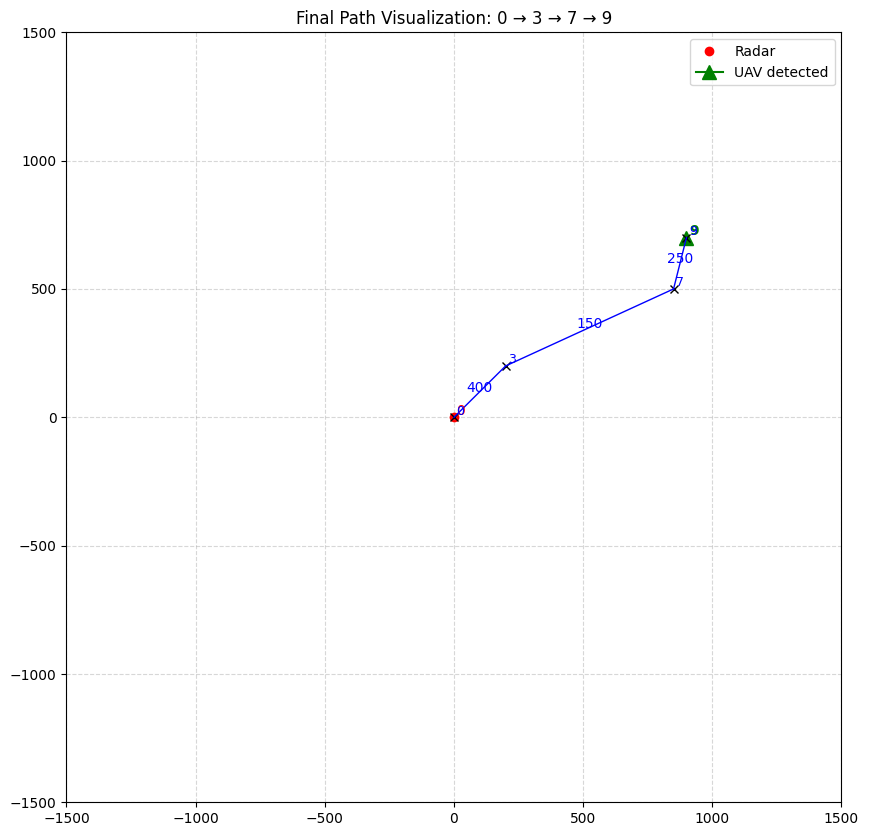

Final weight to reach UAV starting from radar is : 800


In [40]:
grid = 1500
fig, axis = plt.subplots(figsize=(10, 10))
axis.grid(True, linestyle='--', alpha=0.5)
axis.set_xlim(-grid, grid)
axis.set_ylim(-grid, grid)


objects = {
    0: (0, 0), 3: (200, 200), 7: (850, 500), 9: (900, 700)
}
c=0

radar = (0, 0)
uav = (900, 700)

axis.set_title("Final Path Visualization: 0 → 3 → 7 → 9")
axis.plot(radar[0], radar[1], 'ro', label="Radar")
axis.text(radar[0] + 10, radar[1] + 10, "0", color='red')

axis.plot(uav[0], uav[1], marker='^', markersize=10, color='green', label="UAV detected")
axis.text(uav[0] + 10, uav[1] + 10, "9", color='green', fontsize=10, fontweight='bold')

for name, (x, y) in objects.items():
    axis.plot(x, y, 'kx')
    axis.text(x + 10, y + 10, str(name), fontsize=9, color='b')
final_edges = {
    (0, 3): 400, (3, 7): 150, (7, 9): 250
}

# Plot final path edges as solid lines
for (u, v), w in final_edges.items():
    x1, y1 = objects[u]
    x2, y2 = objects[v]
    axis.plot([x1, x2], [y1, y2], 'b-', linewidth=1) 
    axis.text((x1 + x2) / 2, (y1 + y2) / 2, str(w), fontsize=10, color='blue', ha='center')
    c+=w

# Show legend and final plot
axis.legend()
plt.show()
print(f"Final weight to reach UAV starting from radar is : {c}")